# Factors that affect life expectancy

## Data background
The [Life Expectancy dataset](https://www.kaggle.com/kumarajarshi/life-expectancy-who) on Kaggle is collected from the Global Health Observatory (GHO) data repository under World Health Organization (WHO). Factors potentially related to life expectancy fall under several broad categories: Immunization related factors, mortality factors, economical factors, social factors, and a few others. The goal of this project is to identify factors that might increase or decrease life expectancy.

## Load the data

In [1]:
# Import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import style

style.use("fivethirtyeight")
import seaborn as sns
from sqlalchemy import create_engine
from scipy.stats import zscore
from scipy.stats.mstats import winsorize
from scipy import stats
from scipy.stats import jarque_bera
from scipy.stats import normaltest
from scipy.stats import boxcox
import statsmodels.api as sm
from statsmodels.formula.api import ols
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

import warnings

warnings.filterwarnings("ignore")

%matplotlib inline

In [2]:
# PostgreSQL credentials
postgres_user = "dsbc_student"
postgres_pw = "7*.8G9QH21"
postgres_host = "142.93.121.174"
postgres_port = "5432"
postgres_db = "lifeexpectancy"
table_name = "lifeexpectancy"

# Read the data from the lifeexpectancy table
engine = create_engine(
    "postgresql://{}:{}@{}:{}/{}".format(
        postgres_user, postgres_pw, postgres_host, postgres_port, postgres_db
    )
)

original = pd.read_sql_query("select * from lifeexpectancy", con=engine)

engine.dispose()

## Data cleaning

In [3]:
# Remove white spaces in column names at both ends
original.columns = original.columns.str.strip()

# Replace white spaces in the middle with "_"
original.columns = original.columns.str.replace(" ", "_")

### Descriptions

In [4]:
original.shape

(2938, 22)

The Life Expectancy dataset has 2938 rows and 22 columns. Let's look at some descriptive statistics.

In [5]:
# Numeric descriptions
original.describe()

,Year,Life_expectancy,Adult_Mortality,infant_deaths,Alcohol,percentage_expenditure,Hepatitis_B,Measles,BMI,under-five_deaths,Polio,Total_expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness__1-19_years,thinness_5-9_years,Income_composition_of_resources,Schooling
count,2938.000000,2928.000000,2928.000000,2938.000000,2744.000000,2938.000000,2385.000000,2938.000000,2904.000000,2938.000000,2919.000000,2712.00000,2919.000000,2938.000000,2490.000000,2.286000e+03,2904.000000,2904.000000,2771.000000,2775.000000
mean,2007.518720,69.224932,164.796448,30.303948,4.602861,738.251295,80.940461,2419.592240,38.321247,42.035739,82.550188,5.93819,82.324084,1.742103,7483.158469,1.275338e+07,4.839704,4.870317,0.627551,11.992793
std,4.613841,9.523867,124.292079,117.926501,4.052413,1987.914858,25.070016,11467.272489,20.044034,160.445548,23.428046,2.49832,23.716912,5.077785,14270.169342,6.101210e+07,4.420195,4.508882,0.210904,3.358920
min,2000.000000,36.300000,1.000000,0.000000,0.010000,0.000000,1.000000,0.000000,1.000000,0.000000,3.000000,0.37000,2.000000,0.100000,1.681350,3.400000e+01,0.100000,0.100000,0.000000,0.000000
25%,2004.000000,63.100000,74.000000,0.000000,0.877500,4.685343,77.000000,0.000000,19.300000,0.000000,78.000000,4.26000,78.000000,0.100000,463.935626,1.957932e+05,1.600000,1.500000,0.493000,10.100000
50%,2008.000000,72.100000,144.000000,3.000000,3.755000,64.912906,92.000000,17.000000,43.500000,4.000000,93.000000,5.75500,93.000000,0.100000,1766.947595,1.386542e+06,3.300000,3.300000,0.677000,12.300000
75%,2012.000000,75.700000,228.000000,22.000000,7.702500,441.534144,97.000000,360.250000,56.200000,28.000000,97.000000,7.49250,97.000000,0.800000,5910.806335,7.420359e+06,7.200000,7.200000,0.779000,14.300000
max,2015.000000,89.000000,723.000000,1800.000000,17.870000,19479.911610,99.000000,212183.000000,87.300000,2500.000000,99.000000,17.60000,99.000000,50.600000,119172.741800,1.293859e+09,27.700000,28.600000,0.948000,20.700000


Some columns have less than 2938 counts, indicating missing values. 

Some contain impossible values. For instance, since "infant deaths" is the "number of infant deaths per 1000 population", obviously the maximum can't be 1800. Another example is "percentage expenditure" that exceeds 100%. 

Some values are clearly implausible. For instance, no country has a population of just 34 people. Also, BMI can't possibly be as high as 87.3 or as low as 1. These strange values likely arose from measurement errors (e.g., inconsistent units, typos, etc.). Also, 0's in infant deaths, percentage expenditure, and other variables are suspicious and unlikely; they might be used to indicate missing values originally. 

Let's deal missing values and outliers in this messy datasets!

### Deal with missing values

As discussed, 0's were likely used to indicate missing values; let's replace them with such. 

In [6]:
# Replace 0 with missing values
original = original.replace(0, None)

Then let's find out which columns have missing values and the percentage of missing values in each column.

In [7]:
original.isnull().sum() * 100 / original.isnull().count()

Country                             0.000000
Year                                0.000000
Status                              0.000000
Life_expectancy                     0.340368
Adult_Mortality                     0.340368
infant_deaths                       0.000000
Alcohol                             6.603131
percentage_expenditure              0.000000
Hepatitis_B                        18.822328
Measles                             0.000000
BMI                                 1.157250
under-five_deaths                   0.000000
Polio                               0.646698
Total_expenditure                   7.692308
Diphtheria                          0.646698
HIV/AIDS                            0.000000
GDP                                15.248468
Population                         22.191967
thinness__1-19_years                1.157250
thinness_5-9_years                  1.157250
Income_composition_of_resources     5.684139
Schooling                           5.547992
dtype: flo

Since life expectancy is our target variable, imputing or interpolating the missing values in it may change the modeling results. It makes the most sense to drop any rows that don't have life expectancy.

In [8]:
# Create a copy of the original dataframe
lifespan = original.copy()

# Drop rows without life expectancy
lifespan = lifespan.dropna(subset=["Life_expectancy"])

Hepatitis B, GDP, and population have too many missing values, so it also may not make sense to fill in them all. Let's drop them altogether.

In [9]:
# Drop these 3 columns
lifespan = original.drop(["Hepatitis_B", "GDP", "Population"], axis=1)

In theory, we can toss out rows with missing values, replace missing values with means or medians (imputation), or fill in missing values using the average of their closet neighbors (interpolation). Since we only have a few thousand records, there may not be much power left if we discard all rows with missing values. Whether we should impute or interpolate missing values depends on the nature of the data. For instance, for the times series below ([source](https://leportella.com/english/2019/01/14/interpolation.html)), interpolation (red dot) allows us to preserve the periodic pattern but imputation with the mean (green dot) doesn't.

In [10]:
from IPython.display import Image
from IPython.core.display import HTML

Image(url="https://i.imgur.com/G53c1JE.png")

In case of abrupt changes in adjacent values, it's also better to use interpolation than imputation. If values change linearly with time and there are no abrupt changes, both approaches should yield similar results. Taken all together, it's safer to fill in missing values using interpolation.

Because not all countries are alike, we should only interpolate missing values for a given country using existing values from that country. This won't work if a country has no data for a variable, but having unfilled missing values is better than interpolating form other countries' data.

In [11]:
# Interpolate missing values using existing data from each country
lifespan = lifespan.groupby("Country").apply(
    lambda group: group.interpolate(method="index")
)

In [12]:
# Check if there are still missing values
lifespan.isnull().sum() * 100 / lifespan.isnull().count()

Country                            0.000000
Year                               0.000000
Status                             0.000000
Life_expectancy                    0.340368
Adult_Mortality                    0.340368
infant_deaths                      0.000000
Alcohol                            6.535058
percentage_expenditure             0.000000
Measles                            0.000000
BMI                                1.157250
under-five_deaths                  0.000000
Polio                              0.000000
Total_expenditure                  7.147720
Diphtheria                         0.000000
HIV/AIDS                           0.000000
thinness__1-19_years               1.157250
thinness_5-9_years                 1.157250
Income_composition_of_resources    5.684139
Schooling                          5.547992
dtype: float64

A small proportion of data are still missing, suggesting that some countries don't have any data for the corresponding variables.

### Deal with outliers
We can use box plots to visually detect outliers in each variable.

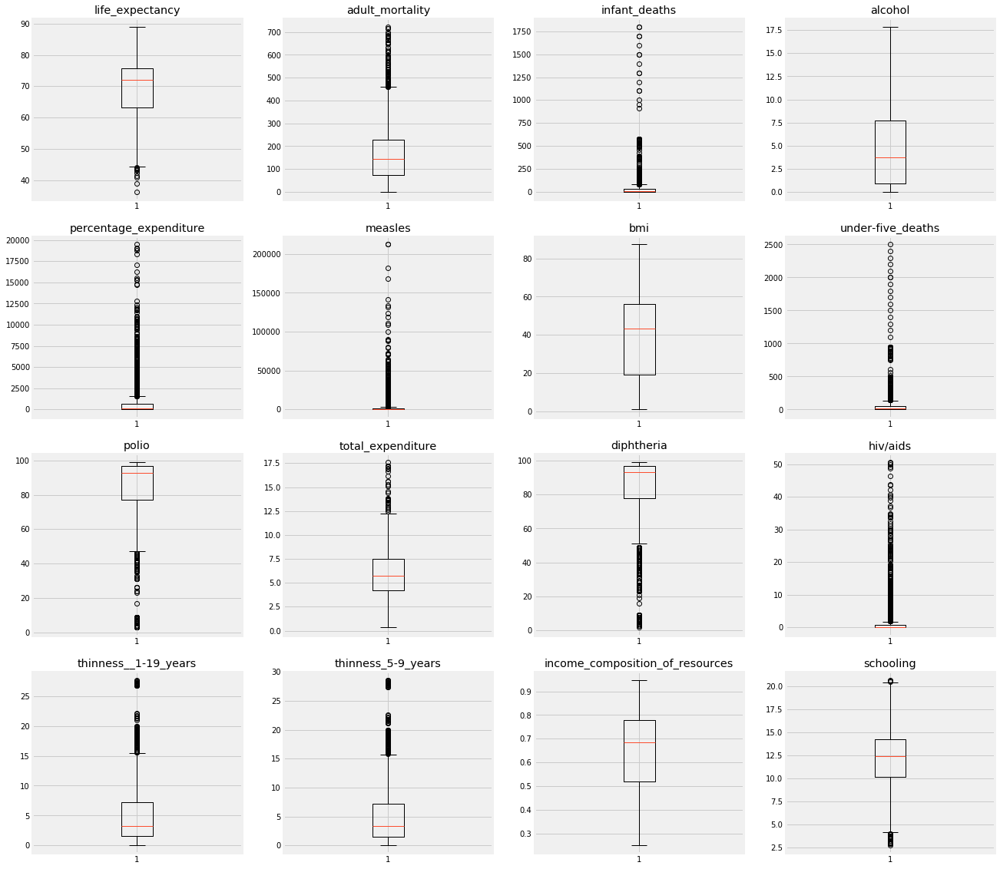

In [13]:
plt.figure(figsize=(20, 20))

i = 1
for column in lifespan.columns[3:]:
    plt.subplot(4, 4, i)
    plt.boxplot(lifespan[column].dropna())
    plt.title("{}".format(column.lower()))
    i += 1

plt.tight_layout
plt.show()

With the exception of BMI, all variables have outliers; some more so than others. 

As mentioned, some outliers are likely due to measurement errors. For example, variables representing numbers per 1,000 population (e.g., adult mortality, HIV/AIDS, etc.) must not exceed 1,000, variables representing percentages (e.g., percentage expenditure, Hepatitis B, etc.) must not exceed 100, and "income composition of resources" should be between 0 and 1 (which is already the case). Here we can drop values that are known to be impossible. In real life, however, I'd doubt the quality of all data in these columns - perhaps values that happen to be within range are still measured incorrectly (e.g., the raw number of measle cases happen to be within 1,000). 

In [14]:
# Equal to or less than 1,000
vars_1000 = [
    "Adult_Mortality",
    "infant_deaths",
    "under-five_deaths",
    "Measles",
    "Polio",
    "HIV/AIDS",
]

for var_1000 in vars_1000:
    lifespan.loc[lifespan[var_1000] > 1000, var_1000] = None

# Equal to or less than 100
vars_100 = [
    "percentage_expenditure",
    "Total_expenditure",
    "Diphtheria",
    "thinness__1-19_years",
    "thinness_5-9_years",
]

for var_100 in vars_100:
    lifespan.loc[lifespan[var_100] > 100, var_100] = None

We may have created many new missing values. Let's check again the proportion of missing values in each column.

In [15]:
lifespan.isnull().sum() * 100 / lifespan.isnull().count()

Country                             0.000000
Year                                0.000000
Status                              0.000000
Life_expectancy                     0.340368
Adult_Mortality                     0.340368
infant_deaths                       0.442478
Alcohol                             6.535058
percentage_expenditure             53.369639
Measles                            26.412526
BMI                                 1.157250
under-five_deaths                   0.544588
Polio                               0.000000
Total_expenditure                   7.147720
Diphtheria                          0.000000
HIV/AIDS                            0.000000
thinness__1-19_years                1.157250
thinness_5-9_years                  1.157250
Income_composition_of_resources     5.684139
Schooling                           5.547992
dtype: float64

Measles and percentage expenditure have too many missing values. Like before, we can drop them and interpolate other missing values by country.

In [16]:
# Drop columns with high % of missing values
lifespan = lifespan.drop(["Measles", "percentage_expenditure"], axis=1)

# Interpolate by country
lifespan = lifespan.groupby("Country").apply(
    lambda group: group.interpolate(method="index")
)

Let's plot the 14 remaining variables again.

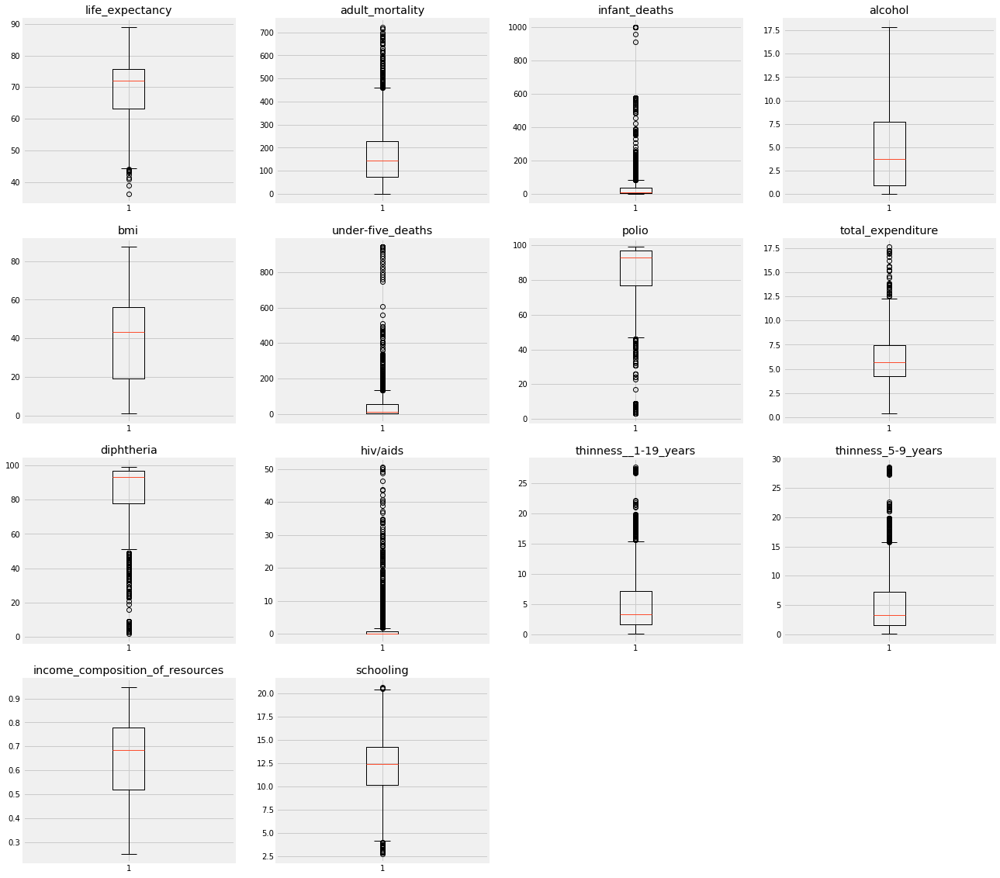

In [17]:
plt.figure(figsize=(20, 20))

i = 1
for column in lifespan.columns[3:]:
    plt.subplot(4, 4, i)
    plt.boxplot(lifespan[column].dropna())
    plt.title("{}".format(column.lower()))
    i += 1

plt.tight_layout
plt.show()

For outliers from valid observations with genuine extreme values, we can use winsorization to reduce them. Depending on where the outliers are located, we can use one-way or two-way winsorization. The target variable life expectancy should be left untouched. 

In [18]:
# One-way for upper tail
uppers = [
    "Adult_Mortality",
    "infant_deaths",
    "Alcohol",
    "under-five_deaths",
    "Total_expenditure",
    "HIV/AIDS",
    "thinness__1-19_years",
    "thinness_5-9_years",
]

for col in uppers:
    lifespan[col] = winsorize(lifespan[col], (0, 0.05))

# One-way for lower tail
lowers = ["Polio", "Diphtheria"]

for col in lowers:
    lifespan[col] = winsorize(lifespan[col], (0.05, 0))

# Two-way
lifespan["Schooling"] = winsorize(lifespan["Schooling"], (0.05, 0.05))

Let's check the outliers one last time.

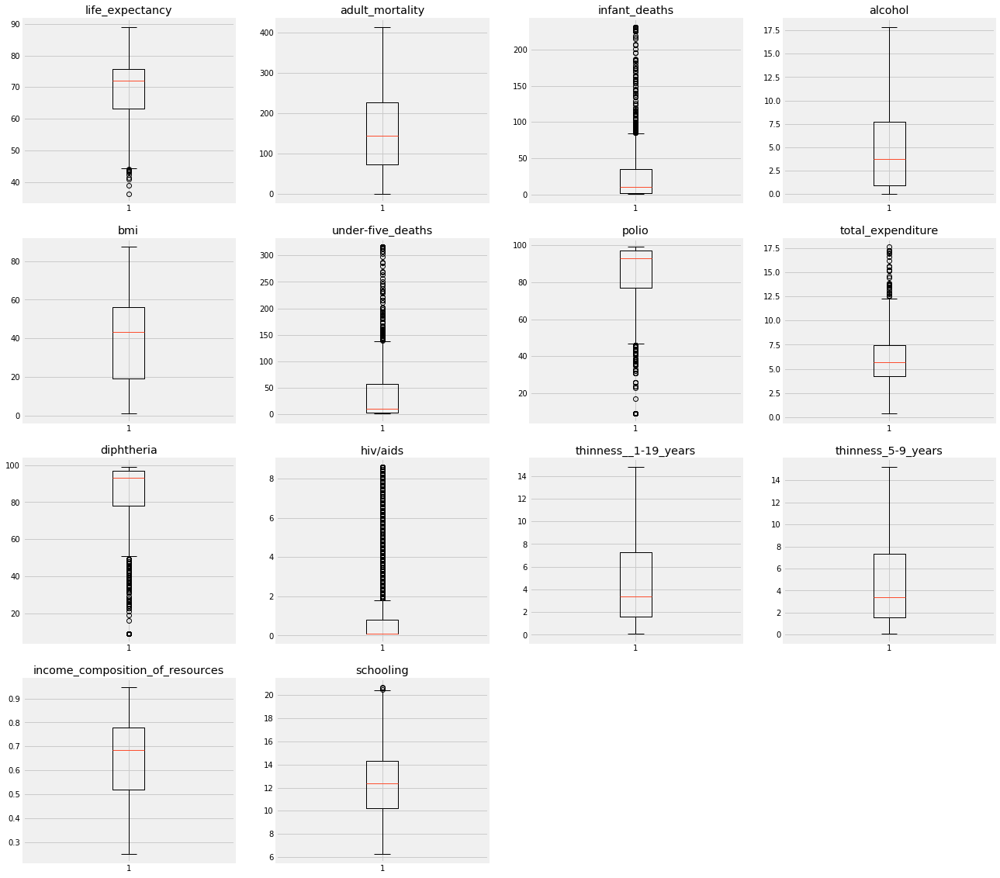

In [19]:
plt.figure(figsize=(20, 20))

i = 1
for column in lifespan.columns[3:]:
    plt.subplot(4, 4, i)
    plt.boxplot(lifespan[column].dropna())
    plt.title("{}".format(column.lower()))
    i += 1

plt.tight_layout
plt.show()

Outliers are reduced but not eliminated. A looser winsorization criterion (e.g., replace values below the 25th or above the 75th percentile) may help eliminate them but would cost us too much data. So let's just leave things here. 

## Data exploration

### Univariate analysis 

As with the raw data, we can first look at the descriptive statistics of the cleaned dataset. 

In [20]:
lifespan.describe(include="O")

,Country,Status
count,2938,2938
unique,193,2
top,Switzerland,Developing
freq,16,2426


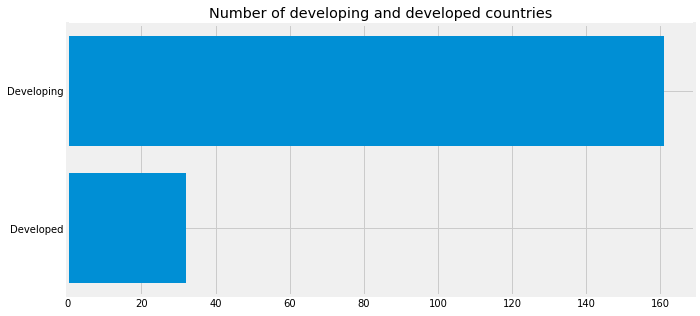

In [21]:
# Bar chart of country status
plt.figure(figsize=(10, 5))
plt.barh(
    lifespan.groupby("Status")["Status"].unique().index,
    lifespan.groupby("Status")["Country"].nunique(),
)
plt.title("Number of developing and developed countries")

plt.show()

There are 193 countries included in this dataset, the vast majority of which are developing countries. 

In [22]:
lifespan.describe()

,Year,Life_expectancy,Adult_Mortality,infant_deaths,Alcohol,BMI,under-five_deaths,Polio,Total_expenditure,Diphtheria,HIV/AIDS,thinness__1-19_years,thinness_5-9_years,Income_composition_of_resources,Schooling
count,2938.000000,2928.000000,2938.000000,2938.000000,2746.000000,2904.000000,2938.000000,2938.000000,2728.000000,2938.000000,2938.000000,2938.000000,2938.000000,2771.000000,2775.000000
mean,2007.518720,69.224932,161.304629,34.242001,4.600496,38.321247,46.489449,82.392784,5.922437,82.163717,1.168788,4.800170,4.829135,0.654907,12.156324
std,4.613841,9.523867,112.697223,56.797057,4.052044,20.044034,77.971600,23.364550,2.500332,23.638207,2.256812,4.024216,4.091031,0.162080,3.023010
min,2000.000000,36.300000,1.000000,1.000000,0.010000,1.000000,1.000000,9.000000,0.370000,9.000000,0.100000,0.100000,0.100000,0.253000,6.300000
25%,2004.000000,63.100000,74.000000,2.000000,0.872500,19.300000,3.000000,77.000000,4.250000,78.000000,0.100000,1.600000,1.600000,0.519000,10.200000
50%,2008.000000,72.100000,144.000000,10.000000,3.745000,43.500000,11.000000,93.000000,5.720000,93.000000,0.100000,3.400000,3.400000,0.684000,12.400000
75%,2012.000000,75.700000,228.000000,35.000000,7.700000,56.200000,57.000000,97.000000,7.472500,97.000000,0.800000,7.300000,7.300000,0.779000,14.300000
max,2015.000000,89.000000,414.000000,231.000000,17.870000,87.300000,316.000000,99.000000,17.600000,99.000000,8.600000,14.800000,15.200000,0.948000,20.700000


Let's plot the distribution of each continuous variable.

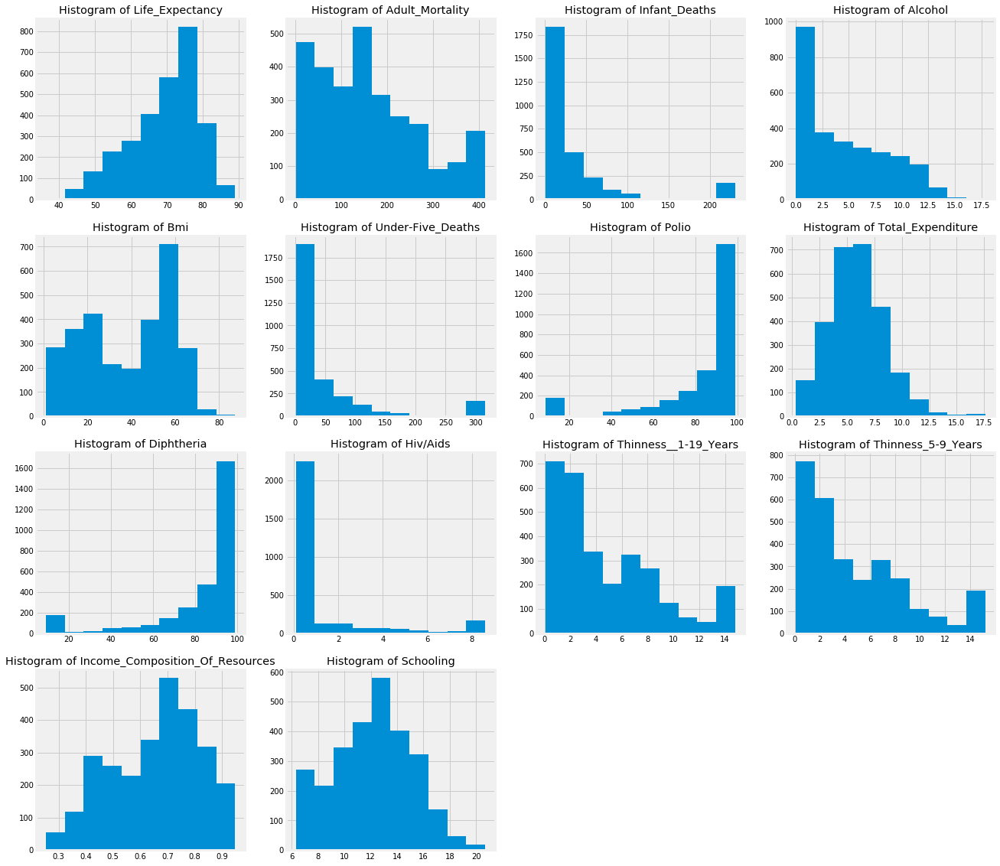

In [23]:
plt.figure(figsize=(20, 20))

i = 1
for column in lifespan.columns[3:]:
    plt.subplot(4, 4, i)
    plt.hist(lifespan[column].dropna())
    plt.title("Histogram of {}".format(column.title()))
    i += 1

plt.tight_layout
plt.show()

None of these variables seem normally distributed. We can also see obvious winsorization effects (bumps at the tails) in these distributions.

### Bivariate analysis 

Let's examine how the other variables might affect our target variable, life expectancy.

#### Continuous vs. continuous
For continuous variables (i.e., all but year and country status), we can look at how well each of them correlates with life expectancy. We can generate a correlation matrix and plot the correlation coefficients on a heat map.

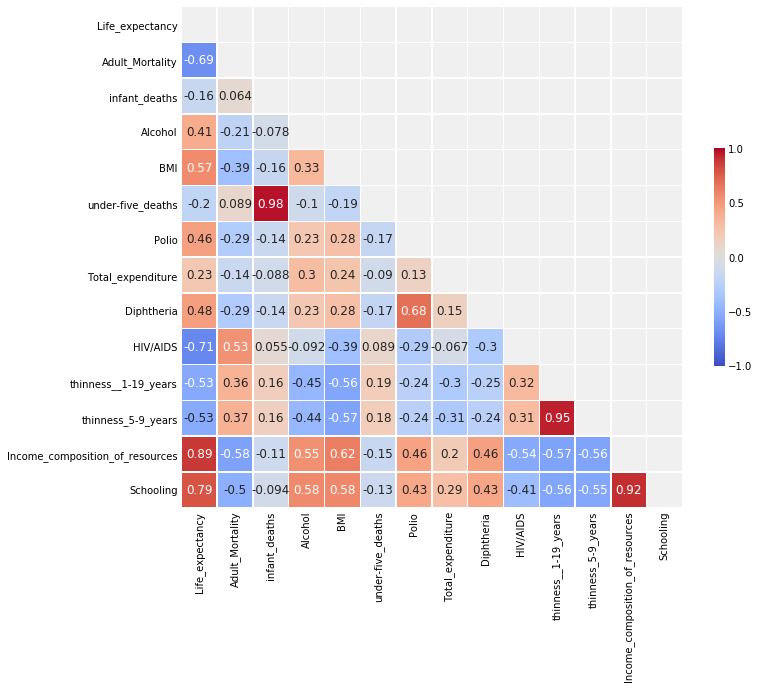

In [24]:
# Generate a correlation matrix
corr = lifespan[lifespan.columns[3:]].corr()

# Hide upper triangle
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

# Generate heatmap
f, ax = plt.subplots(figsize=(10, 10))
heatmap = sns.heatmap(
    corr,
    mask=mask,
    square=True,
    linewidths=0.5,
    cmap="coolwarm",
    cbar_kws={"shrink": 0.4, "ticks": [-1, -0.5, 0, 0.5, 1]},
    vmin=-1,
    vmax=1,
    annot=True,
    annot_kws={"size": 12},
)

# add the column names as labels
ax.set_yticklabels(corr.columns, rotation=0)
ax.set_xticklabels(corr.columns)
sns.set_style({"xtick.bottom": True}, {"ytick.left": True})

Looking at the first column, we can see that factors such as schooling and income composition of resources have strong positive correlations with life expectancy. On the other hand, HIV/AIDS and thinness (ages 5-9 and 10-19) have strong negative correlations with life expectancy. Factors such as total expenditure and infants deaths (surprisingly), however, don't seem to play much of a role.

#### Categorical vs. continuous
There are two categorical variables (or predictors) in the dataset, year and country status (developed vs. developing). We can look at whether life expectancy has changed over the years and whether the trend is the same for developed and developing countries.

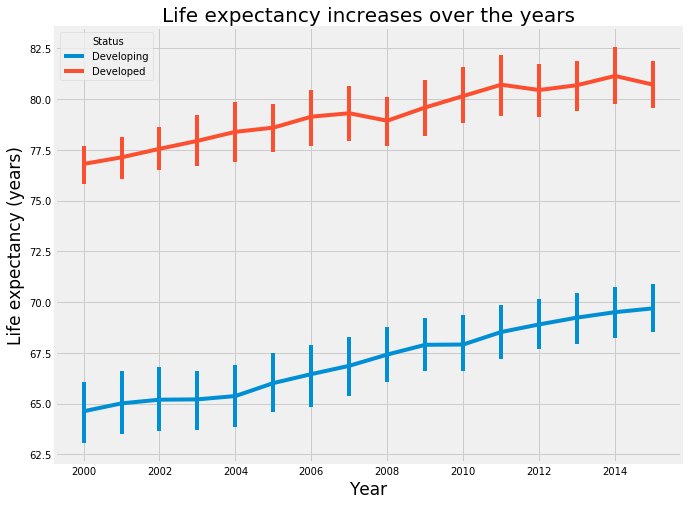

In [50]:
plt.figure(figsize=(10, 8))
sns.lineplot(
    x="Year", y="Life_expectancy", hue="Status", data=lifespan, err_style="bars", ci=95
)
plt.title("Life expectancy increases over the years", fontsize=20)
plt.xlabel("Year", fontsize=17)
plt.ylabel("Life expectancy (years)", fontsize=17)
plt.show()

Overall, life expectancy seems to be linearly increasing over the years, albeit a little bit more slowly in developed countries. At any given year, the average life expectancy in developed countries seems much higher than that in developing countries.

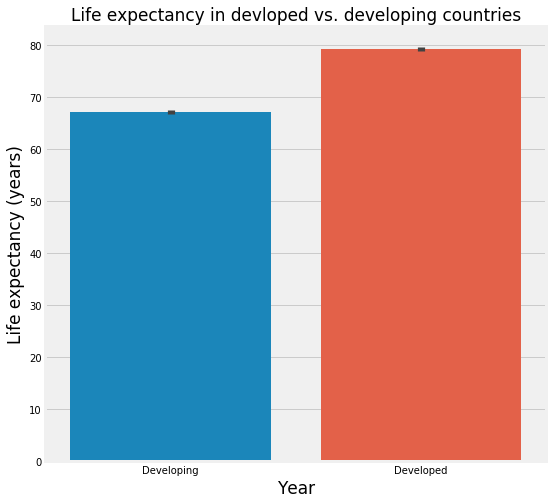

In [49]:
# Plot life expectancy for country status
plt.figure(figsize=(8, 8))
ax = sns.barplot(x="Status", y="Life_expectancy", data=lifespan)
plt.title("Life expectancy in devloped vs. developing countries", fontsize=17)
plt.xlabel("Year", fontsize=17)
plt.ylabel("Life expectancy (years)", fontsize=17)
plt.show()

We can use a two-way ANOVA to test whether year and status each have a significant impact on life expectancy and whether there is a significant interaction between the two.

In [27]:
model = ols(
    "Life_expectancy ~ C(Status) + C(Year) + C(Status):C(Year)", data=lifespan
).fit()
anova_table = sm.stats.anova_lm(model, typ=2)
anova_table

,sum_sq,df,F,PR(>F)
C(Status),61714.719937,1.0,912.316333,1.835387e-174
C(Year),7750.137691,15.0,7.637915,5.073521e-17
C(Status):C(Year),122.549020,15.0,0.120775,9.999845e-01
Residual,195903.353338,2896.0,NaN,NaN


While the main effects of status and year are both significant, the interaction between the two is not. This indicates life expectancy increases more or less similar in developed and developing countries over the years.

## Feature engineering

#### Dummy coding

Since most models only take numeric values as input, we need to use dummy coding on country status where strings are used to represent different levels. "Developed" and "Developing" are coded as 0 and 1, respectively. 

In [28]:
lifespan = pd.concat([lifespan, pd.get_dummies(lifespan["Status"])], axis=1)

We need only one of the dummy variables (e.g., "Developing") as they contain exactly the same information. 

In [29]:
lifespan = lifespan.drop(["Developing"], axis=1)

#### Normalizing
Some models assume the target variable to be normally distributed. In this case, we can use the [Jarque-Bera test](https://en.wikipedia.org/wiki/Jarque%E2%80%93Bera_test) and [D'Agostino's K-squared test](https://en.wikipedia.org/wiki/D%27Agostino%27s_K-squared_test) to examine the normality of our target variable - life expectancy. Both tests are included in the `stats` package in SciPy.

In [30]:
jb_stats = jarque_bera(lifespan["Life_expectancy"].dropna())
norm_stats = normaltest(lifespan["Life_expectancy"].dropna())

print(
    "Jarque-Bera test statistics is {0} and p value is {1}".format(
        jb_stats[0], jb_stats[1]
    )
)
print(
    "Normality test statistics is {0} and p value is {1}".format(
        norm_stats[0], norm_stats[1]
    )
)

Jarque-Bera test statistics is 205.61247743959427 and p value is 0.0
Normality test statistics is 177.35500491008625 and p value is 3.075034656878767e-39


The tests suggest that life expectancy is not normally distributed. We can use log transformation to normalize it.

In [31]:
# Normalize life expectancy
lifespan["Life_expectancy_log"] = np.log(lifespan["Life_expectancy"])


# Test normality again
jb_stats = jarque_bera(lifespan["Life_expectancy_log"].dropna())
norm_stats = normaltest(lifespan["Life_expectancy_log"].dropna())

print(
    "Jarque-Bera test statistics is {0} and p value is {1}".format(
        jb_stats[0], jb_stats[1]
    )
)
print(
    "Normality test statistics is {0} and p value is {1}".format(
        norm_stats[0], norm_stats[1]
    )
)

Jarque-Bera test statistics is 453.83835318057197 and p value is 0.0
Normality test statistics is 333.31012113219225 and p value is 4.193984440244729e-73


Unfortunately, the new distribution of life expectancy is still not normal. We can plot the histograms before and after the transformation.

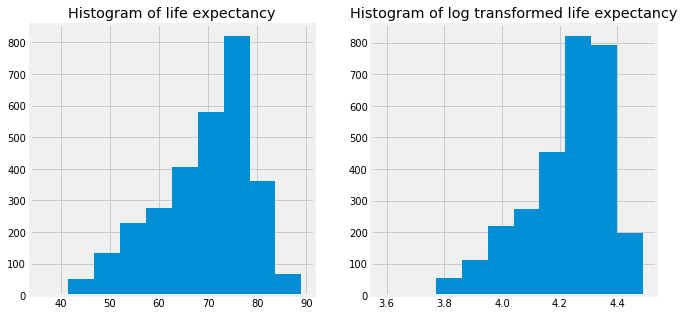

In [32]:
plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.hist(lifespan["Life_expectancy"].dropna())
plt.title("Histogram of life expectancy")

plt.subplot(1, 2, 2)
plt.hist(lifespan["Life_expectancy_log"].dropna())
plt.title("Histogram of log transformed life expectancy")

plt.tight_layout
plt.show()

Perhaps the distribution of life expectancy is too skewed to normalize.

#### Correlation matrix 
In see which variables are most strongly correlated with our target variable, we can again generate a correlation matrix.

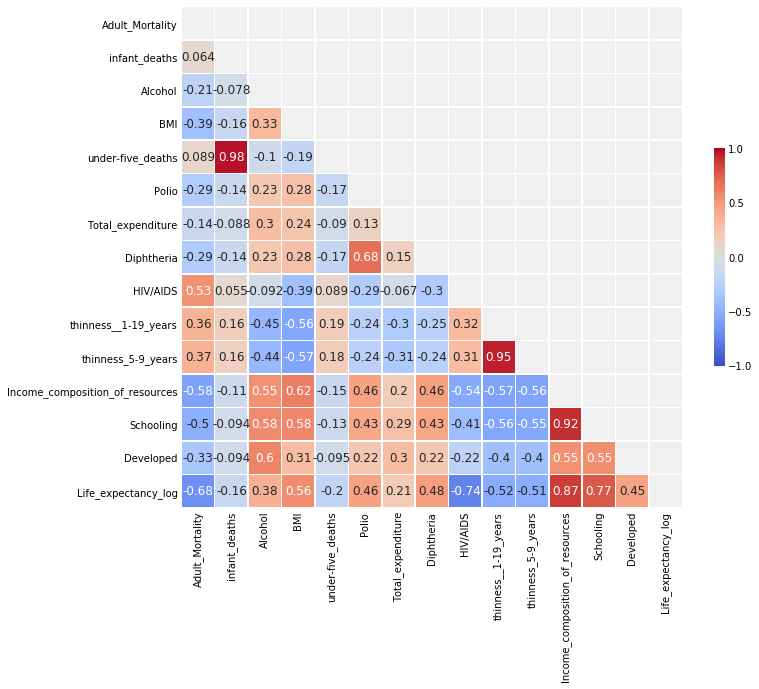

In [33]:
# Generate a correlation matrix
corr = lifespan[lifespan.columns[4:]].corr()

# Hide upper triangle
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

# Generate heatmap
f, ax = plt.subplots(figsize=(10, 10))
heatmap = sns.heatmap(
    corr,
    mask=mask,
    square=True,
    linewidths=0.5,
    cmap="coolwarm",
    cbar_kws={"shrink": 0.4, "ticks": [-1, -0.5, 0, 0.5, 1]},
    vmin=-1,
    vmax=1,
    annot=True,
    annot_kws={"size": 12},
)

# add the column names as labels
ax.set_yticklabels(corr.columns, rotation=0)
ax.set_xticklabels(corr.columns)
sns.set_style({"xtick.bottom": True}, {"ytick.left": True})

As can be seen from above, HIV/AIDS, income composition of resources, and schooling are most strongly correlated with life expectancy. However, it can be problematic to select features based on pairwise correlations. For instance, some variables may not be strongly correlated with the target variable by themselves but have strong predictive power in conjunction with other variables. If we throw them away, it will reduce our model accuracy. Also, some variables may seem to correlate well with the target variable but are also highly correlated with other variables; including them won't provide us with additional information. To address these concerns, we can use principal component analysis (PCA).

#### PCA
According to [this article](https://www.statisticssolutions.com/principal-component-analysis-pca/), PCA makes some assumptions about the data:

1. **Sample size**: Ideally, there should be 150+ cases and there should be ratio of at least five cases for each variable.
2. **Correlations**: There should be some correlation among the factors to be considered for PCA.
3. **Linearity**: The relationship between the variables are linearly related.
4. **Outliers**: PCA is sensitive to outliers; they should be removed.

We have nearly 3,000 cases and the case to variable ratio is over 190:1, so the sample assumption is satisfied. From the correlation matrix, we can see that apart from a few exceptions (e.g., HIV/AIDS and total expenditure), the rest of the variables are all somewhat correlated with one another. So the correlation assumption is also satisfied. We can use pairplots to visualize the relationship between each pair of variables. 

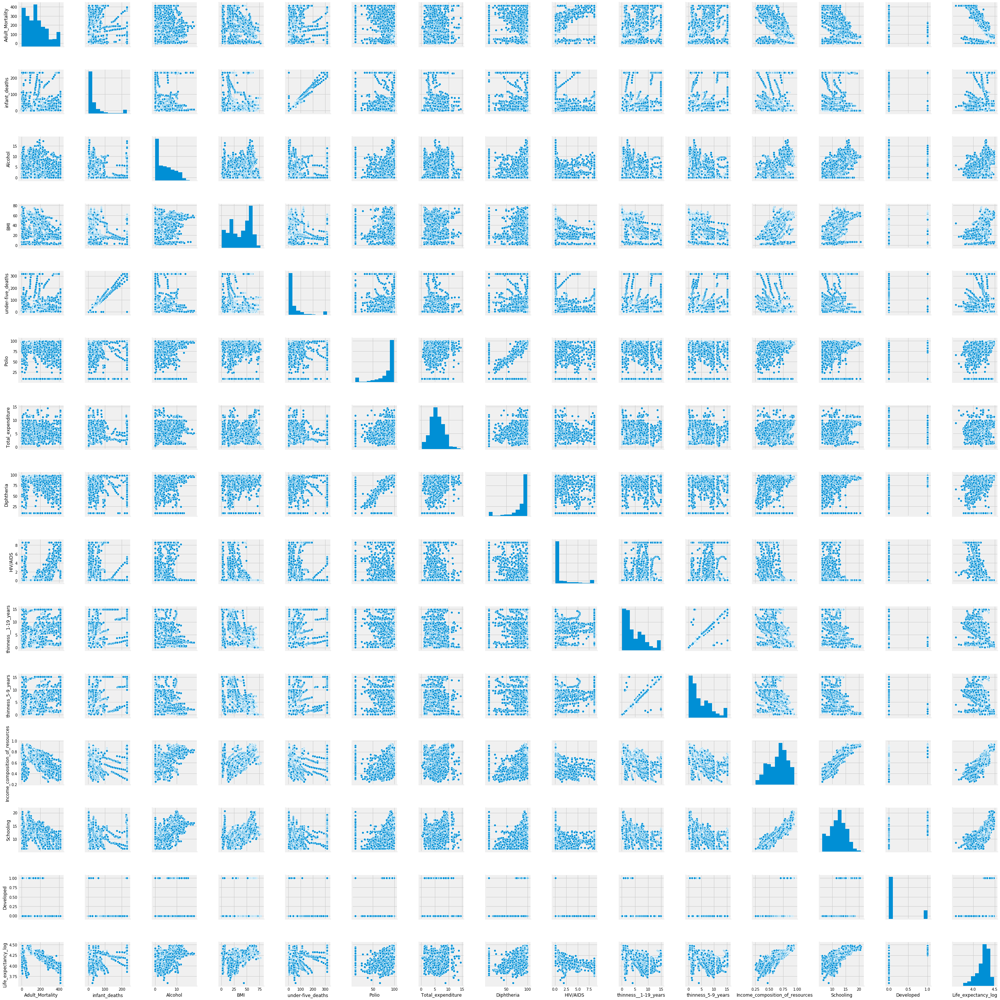

In [34]:
sns.pairplot(lifespan[lifespan.columns[4:]].dropna())
plt.show()

That's a lot of plots! As we can see, most pairs don't have a linear relationship, so the linearity assumption is not satisfied. Also, since we still have a few outliers after winsorization, the outlier assumption isn't satisfied, either. Overall, this dataset is not 100% suitable for PCA. Nevertheless, we can try to use PCA to extract important features, even though we need to take a grain of salt about the results.

In [35]:
# Create a new dataframe without missing values
df = lifespan.dropna()

# Names of features
features = df.columns[4:]

# Separating out the features
x = df.loc[:, features].values

# Separating out the target
y = df.loc[:, ["Life_expectancy_log"]].values

# Standardizing the features
x = StandardScaler().fit_transform(x)

As mentioned the very beginning, there are 4 broad categories of factors (immunization, mortality, economical, social) that influence life expectancy so we can set the number of principal components to be 4 - although this may not necessarily be the case.

In [36]:
# PCA projection: 16D to 4D
pca = PCA(n_components=4)
principalComponents = pca.fit_transform(x)
principalDf = pd.DataFrame(
    data=principalComponents,
    columns=[
        "principal component 1",
        "principal component 2",
        "principal component 3",
        "principal component 4",
    ],
)

In [37]:
# View the principle component data frame
principalDf.head()

,principal component 1,principal component 2,principal component 3,principal component 4
0,3.881649,0.659009,-0.333878,0.533486
1,3.698646,0.562515,-0.896435,-0.476278
2,3.678341,0.601903,-0.999152,-0.585359
3,3.651819,0.641215,-1.048710,-0.807606
4,3.758908,0.687232,-1.148417,-0.784729


In [38]:
# Concatenate it with the target
finalDf = pd.concat([principalDf, df[["Life_expectancy_log"]]], axis=1)

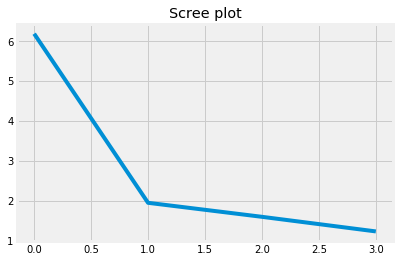

PC1 Explained Variance: 41.25%
Total variance explained: 72.96%


In [41]:
# Explained variance
plt.plot(pca.explained_variance_)
plt.title('Scree plot')
plt.show()
print(
    "PC1 Explained Variance:",
    str(round(pca.explained_variance_ratio_[0] * 100, 2)) + "%",
)
print(
    "Total variance explained:",
    str(round(pca.explained_variance_ratio_.sum() * 100, 2)) + "%",
)

Together, the 4 principal components explain 72.96% of the total variance. The first principal component alone explains 41.25% of the variance. When building models, we can use these principal components rather than individual features to make predictions (see [here](http://www.sthda.com/english/articles/31-principal-component-methods-in-r-practical-guide/118-principal-component-analysis-in-r-prcomp-vs-princomp/)).

## Summary of findings

The Life Expectancy dataset on Kaggle has information on 193 countries' life expectancy from 2000 to 2015, along with factors that might help predict life expectancy. Ultimately, we can use this dataset to find out what factors may increase or decrease life expectancy. 

Unfortunately, the quality of this dataset is dubious: Some variables exceed their theoretical maximums (e.g., 212,183 cases of measle per 1,000) while others are extremely implausible (e.g., a country with a population of 34, a 1.68 GDP). According to the Kaggle [discussion page](https://www.kaggle.com/kumarajarshi/life-expectancy-who/discussion), there are more issues with this dataset. For example, the GDP variable doesn't use unified currencies, countries like Canada are falsely labeled as "developing", etc.. In real life, I may choose a more reliable data source to identify factors that may influence life expectancy. For this exploratory analysis project, I worked with what I had by dropping impossible values, interpolating missing values, and winsorizing outliers.

First all, life expectancy around the world increased from 2000 to 2015. The trend is the same for both developing and developed countries.

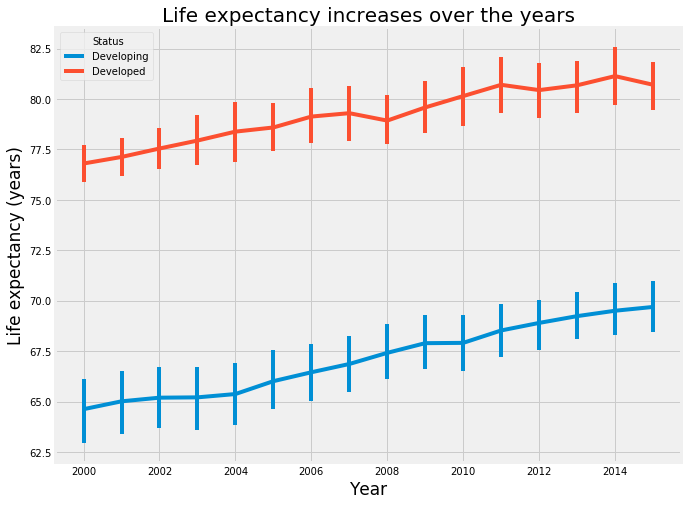

In [48]:
plt.figure(figsize=(10, 8))
sns.lineplot(
    x="Year", y="Life_expectancy", hue="Status", data=lifespan, err_style="bars", ci=95
)
plt.title("Life expectancy increases over the years", fontsize=20)
plt.xlabel("Year", fontsize=17)
plt.ylabel("Life expectancy (years)", fontsize=17)
plt.show()

Second of all, some factors are more strongly correlated with our target variable life expectancy than others. For instance, while more years of schooling is associated with longer life expectancy, higher death rates from HIV/AIDS and adult mortality predict shorter life expectancy. Some factors don't seem to be strongly correlated with life expectancy, such as infant deaths and under-five deaths. There are also factors that correlate well with life expectancy but don't provide much information. For instance, "income composition of resources" or Human Development Index (HDI) is in part computed from life expectancy, so it wouldn't be surprising that all that it's strongly correlated with it.

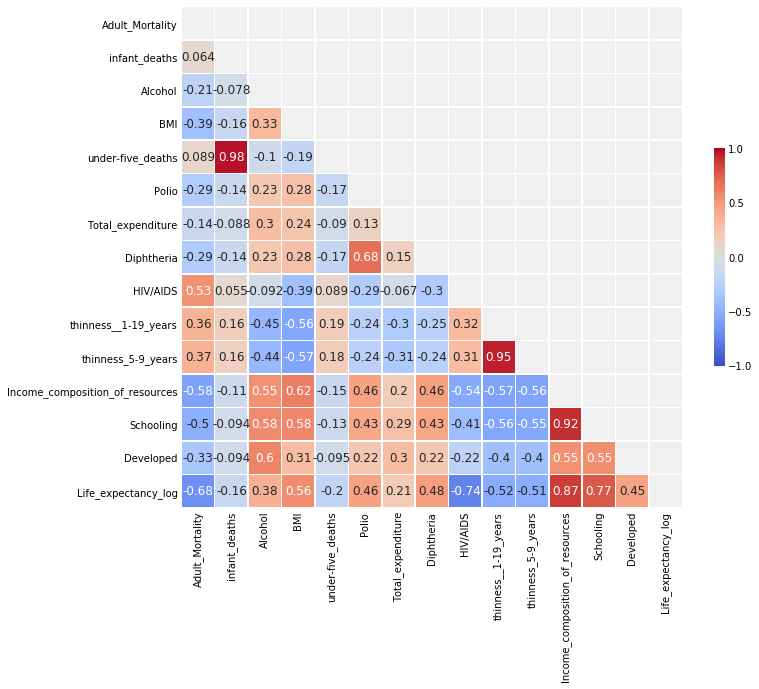

In [47]:
# Generate a correlation matrix
corr = lifespan[lifespan.columns[4:]].corr()

# Hide upper triangle
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

# Generate heatmap
f, ax = plt.subplots(figsize=(10, 10))
heatmap = sns.heatmap(
    corr,
    mask=mask,
    square=True,
    linewidths=0.5,
    cmap="coolwarm",
    cbar_kws={"shrink": 0.4, "ticks": [-1, -0.5, 0, 0.5, 1]},
    vmin=-1,
    vmax=1,
    annot=True,
    annot_kws={"size": 12},
)

# add the column names as labels
ax.set_yticklabels(corr.columns, rotation=0)
ax.set_xticklabels(corr.columns)
sns.set_style({"xtick.bottom": True}, {"ytick.left": True})

Lastly, principal component analysis (PCA) shows that one principal component can explain 41.25% of the variance in life expectancy. With 4 principal components, we can explain the most (72.96%) variance. However, it will take further analysis to see how each variable is projected onto the principal component space. That way, we can better understand what features to include in our model.

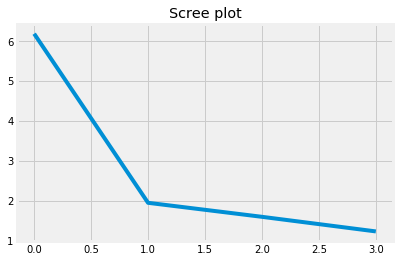

PC1 Explained Variance: 41.25%
Total variance explained: 72.96%


In [52]:
plt.plot(pca.explained_variance_)
plt.title('Scree plot')
plt.show()
print(
    "PC1 Explained Variance:",
    str(round(pca.explained_variance_ratio_[0] * 100, 2)) + "%",
)
print(
    "Total variance explained:",
    str(round(pca.explained_variance_ratio_.sum() * 100, 2)) + "%",
)